In [1]:
# global feature extraction
#import the necessary libraries we need to work with
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
import numpy as np
import mahotas
import cv2
import os
import h5py
import numpy as np
import matplotlib.pyplot as plt
# tunable-parameters
images_per_class       = 800
#convert the input image to a fixed size of (500, 500)
fixed_size             = tuple((500, 500))
train_path             = "C:/Users/katya/plantDiseaseDetection/dataset/train"
#stores our global features and labels in output directory.
h5_train_data          = "C:/Users/katya/plantDiseaseDetection/output/train_data.h5"
h5_train_labels        = "C:/Users/katya/plantDiseaseDetection/output/train_labels.h5"
#the number of bins for color histograms
bins                   = 8

In [2]:
# converting each image from BGR to RGB format
def bgr_rgb(image):
    rgb_img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return rgb_img

In [3]:
# Conversion to HSV image format from RGB format
def rgb_hsv(rgb_img):
    hsv_img = cv2.cvtColor(rgb_img, cv2.COLOR_BGR2HSV)
    return hsv_img

In [4]:
# image segmentation- for extraction of green and brown color
def img_segmentation(rgb_img,hsv_img):
    lower_green = np.array([25,0,20])
    upper_green = np.array([100,255,255])
    healthy_mask = cv2.inRange(hsv_img, lower_green, upper_green)
    result = cv2.bitwise_and(rgb_img,rgb_img, mask=healthy_mask)
    lower_brown = np.array([10,0,10])
    upper_brown = np.array([30,255,255])
    disease_mask = cv2.inRange(hsv_img, lower_brown, upper_brown)
    disease_result = cv2.bitwise_and(rgb_img, rgb_img, mask=disease_mask)
    final_mask = healthy_mask + disease_mask
    final_result = cv2.bitwise_and(rgb_img, rgb_img, mask=final_mask)
    return final_result

In [5]:
# feature-descriptor-1: Hu Moments for shape
def fd_hu_moments(image):
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    feature = cv2.HuMoments(cv2.moments(image)).flatten()
    return feature

In [6]:
# feature-descriptor-2: Haralick Texture for texture
def fd_haralick(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    haralick = mahotas.features.haralick(gray).mean(axis=0)
    return haralick

In [7]:
# feature-descriptor-3: Color Histogram for color
def fd_histogram(image, mask=None):
    image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    hist  = cv2.calcHist([image], [0, 1, 2], None, [bins, bins, bins], [0, 256, 0, 256, 0, 256])
    cv2.normalize(hist, hist)
    return hist.flatten()

In [8]:
# get the training labels
train_labels = os.listdir(train_path)

# sort the training labels
train_labels.sort()
print(train_labels)

# empty lists to hold feature vectors and labels
global_features = []
labels          = []

['diseased', 'healthy']


In [9]:
# loop over the training data sub-folders
for training_name in train_labels:
    # join the training data path and each species training folder
    dir = os.path.join(train_path, training_name)

    # get the current training label
    current_label = training_name

    # loop over the images in each sub-folder
    for x in range(1,images_per_class+1):
        # get the image file name
        file = dir + "/" + str(x) + ".jpg"

        # read the image and resize it to a fixed-size
        image = cv2.imread(file)
        image = cv2.resize(image, fixed_size)

        # Running Function Bit By Bit
        
        BGR_RGB       = bgr_rgb(image)
        RGB_HSV       = rgb_hsv(BGR_RGB)
        IMG_SEGMENT   = img_segmentation(BGR_RGB,RGB_HSV)

        # Call for Global Feature Descriptors
        
        fv_hu_moments = fd_hu_moments(IMG_SEGMENT)
        fv_haralick   = fd_haralick(IMG_SEGMENT)
        fv_histogram  = fd_histogram(IMG_SEGMENT)
        ###################################
        # Concatenate global features
        ###################################
        global_feature = np.hstack([fv_histogram, fv_haralick, fv_hu_moments])

        # update the list of labels and feature vectors
        labels.append(current_label)
        global_features.append(global_feature)
    print("[STATUS] processed folder: {}".format(current_label))
print("[STATUS] completed Global Feature Extraction...")

[STATUS] processed folder: diseased
[STATUS] processed folder: healthy
[STATUS] completed Global Feature Extraction...


In [10]:
# get the overall feature vector size
print("[STATUS] feature vector size {}".format(np.array(global_features).shape))

[STATUS] feature vector size (1600, 532)


In [11]:
# get the overall training label size
print("[STATUS] training Labels {}".format(np.array(labels).shape))

[STATUS] training Labels (1600,)


In [12]:
# encode the target labels
targetNames = np.unique(labels)
le          = LabelEncoder()
target      = le.fit_transform(labels)
print("[STATUS] training labels encoded...")

[STATUS] training labels encoded...


In [13]:
# scale features in the range (0-1)
from sklearn.preprocessing import MinMaxScaler
scaler            = MinMaxScaler(feature_range=(0, 1))
rescaled_features = scaler.fit_transform(global_features)
print("[STATUS] feature vector normalized...")

[STATUS] feature vector normalized...


In [14]:
print("[STATUS] target labels: {}".format(target))
print("[STATUS] target labels shape: {}".format(target.shape))

[STATUS] target labels: [0 0 0 ... 1 1 1]
[STATUS] target labels shape: (1600,)


In [15]:
# save the feature vector using HDF5
h5f_data = h5py.File(h5_train_data, 'w')
h5f_data.create_dataset('dataset_1', data=np.array(rescaled_features))

<HDF5 dataset "dataset_1": shape (1600, 532), type "<f8">

In [16]:
h5f_label = h5py.File(h5_train_labels, 'w')
h5f_label.create_dataset('dataset_1', data=np.array(target))

<HDF5 dataset "dataset_1": shape (1600,), type "<i8">

In [17]:
h5f_data.close()
h5f_label.close()
print("[STATUS] end of training....")

[STATUS] end of training....


In [18]:
# training the models
import h5py
import numpy as np
import os
import glob
import cv2
import warnings
from matplotlib import pyplot
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.model_selection import KFold, StratifiedKFold
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
import joblib

warnings.filterwarnings('ignore')
# tunable-parameters
num_trees = 100
#split size is decided by the test_size
test_size = 0.20
#initialize the random number generator
seed      = 9
train_path = "C:/Users/katya/plantDiseaseDetection/dataset/train"
test_path  = "C:/Users/katya/plantDiseaseDetection/dataset/test"
h5_train_data    = "C:/Users/katya/plantDiseaseDetection/output/train_data.h5"
h5_train_labels  = "C:/Users/katya/plantDiseaseDetection/output/train_labels.h5"
scoring    = "accuracy"
# get the training labels
train_labels = os.listdir(train_path)

# sort the training labels
train_labels.sort()

if not os.path.exists(test_path):
    os.makedirs(test_path)

# create all the machine learning models
models = []
models.append(('LR', LogisticRegression(random_state=seed)))
models.append(('LDA', LinearDiscriminantAnalysis()))
models.append(('KNN', KNeighborsClassifier()))
models.append(('CART', DecisionTreeClassifier(random_state=seed)))
models.append(('RF', RandomForestClassifier(n_estimators=num_trees, random_state=seed)))
models.append(('NB', GaussianNB()))
models.append(('SVM', SVC(random_state=seed)))

# variables to hold the results and names
results = []
names   = []

# import the feature vector and trained labels
h5f_data  = h5py.File(h5_train_data, 'r')
h5f_label = h5py.File(h5_train_labels, 'r')

global_features_string = h5f_data['dataset_1']
global_labels_string   = h5f_label['dataset_1']

#np.array() function to convert the .h5 data into a numpy array and then print its shape
global_features = np.array(global_features_string)
global_labels   = np.array(global_labels_string)

h5f_data.close()
h5f_label.close()

# verify the shape of the feature vector and labels
print("[STATUS] features shape: {}".format(global_features.shape))
print("[STATUS] labels shape: {}".format(global_labels.shape))

print("[STATUS] training started...")

[STATUS] features shape: (1600, 532)
[STATUS] labels shape: (1600,)
[STATUS] training started...


In [19]:
# split the training and testing data
(trainDataGlobal, testDataGlobal, trainLabelsGlobal, testLabelsGlobal) = train_test_split(np.array(global_features),
                                                                                          np.array(global_labels),
                                                                                          test_size=test_size,
                                                                                          random_state=seed)

print("[STATUS] splitted train and test data...")
print("Train data  : {}".format(trainDataGlobal.shape))
print("Test data   : {}".format(testDataGlobal.shape))
print("Train labels  : {}".format(trainLabelsGlobal.shape))
print("Test labels   : {}".format(testLabelsGlobal.shape))

[STATUS] splitted train and test data...
Train data  : (1280, 532)
Test data   : (320, 532)
Train labels  : (1280,)
Test labels   : (320,)


In [20]:
trainDataGlobal

array([[0.97898566, 0.00583762, 0.        , ..., 0.00359595, 0.07831085,
        0.98227255],
       [0.8782435 , 0.03850996, 0.01147501, ..., 0.00359595, 0.07830863,
        0.98227254],
       [0.88599139, 0.02229556, 0.01254733, ..., 0.00359624, 0.07857901,
        0.98227395],
       ...,
       [0.66533593, 0.        , 0.        , ..., 0.00359595, 0.07831198,
        0.98227256],
       [0.95860282, 0.        , 0.        , ..., 0.00359584, 0.07852883,
        0.98228417],
       [0.97543979, 0.23404012, 0.07907152, ..., 0.00359598, 0.07832764,
        0.98227188]])

LR: 0.931250 (0.020313)
LDA: 0.919531 (0.017832)
KNN: 0.945312 (0.019764)
CART: 0.915625 (0.019073)
RF: 0.961719 (0.010740)
NB: 0.823438 (0.026654)
SVM: 0.932031 (0.022656)


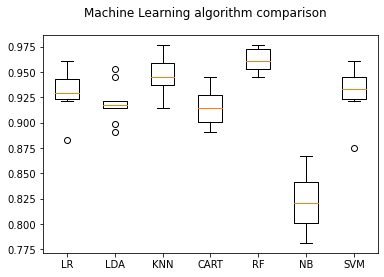

In [21]:
# 10-fold cross validation to evaluate each model in turn
for name, model in models:
    kfold = KFold(n_splits=10, random_state=seed)
    cv_results = cross_val_score(model, trainDataGlobal, trainLabelsGlobal, cv=kfold, scoring=scoring)
    results.append(cv_results)
    names.append(name)
    msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
    print(msg)
# boxplot algorithm comparison
fig = pyplot.figure()
fig.suptitle('Machine Learning algorithm comparison')
ax = fig.add_subplot(111)
pyplot.boxplot(results)
ax.set_xticklabels(names)
pyplot.show()

In [22]:
# TESTING OUR MODEL
# to visualize results
import matplotlib.pyplot as plt
# create the model - Random Forests
clf  = RandomForestClassifier(n_estimators=num_trees, random_state=seed)

In [23]:
# fit the training data to the model
clf.fit(trainDataGlobal, trainLabelsGlobal)

RandomForestClassifier(random_state=9)

In [24]:
#predict() returns array with multiple predicted labels
y_predict=clf.predict(testDataGlobal)
y_predict

array([1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1,
       0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0,
       1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0,
       0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1,
       0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,
       0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1,
       0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0,
       0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0,
       0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1,
       1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1,
       0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0,

In [25]:
#confusion matrix
cm = confusion_matrix(testLabelsGlobal,y_predict)
print(cm)

[[152   6]
 [  4 158]]


<AxesSubplot:>

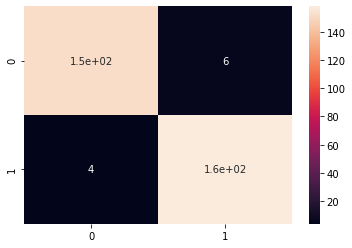

In [26]:
#visualize the confusion matrix
import seaborn as sns
sns.heatmap(cm ,annot=True)

In [27]:
print(classification_report(testLabelsGlobal,y_predict))

              precision    recall  f1-score   support

           0       0.97      0.96      0.97       158
           1       0.96      0.98      0.97       162

    accuracy                           0.97       320
   macro avg       0.97      0.97      0.97       320
weighted avg       0.97      0.97      0.97       320



In [28]:
from sklearn.metrics import accuracy_score
accuracy_score(testLabelsGlobal, y_predict)

0.96875

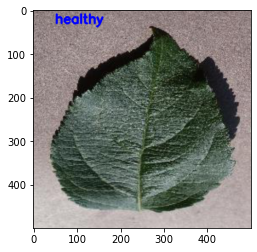

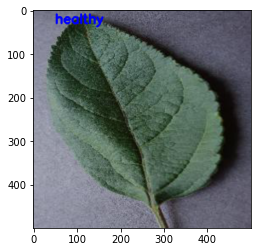

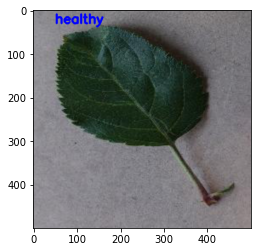

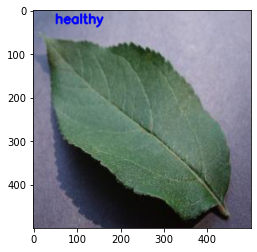

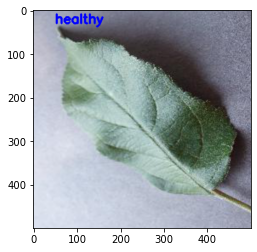

...

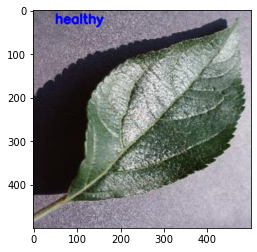

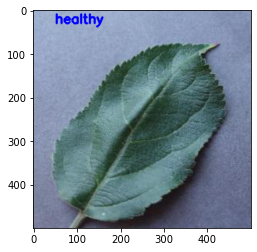

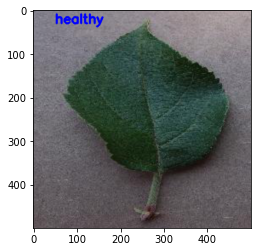

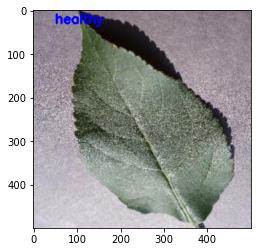

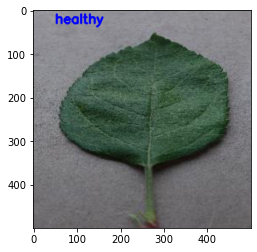

In [29]:
#TESTING
# loop through the test images
for file in glob.glob(test_path + "/*.jpg"):
    # read the image
    image = cv2.imread(file)
    # resize the image
    image = cv2.resize(image, fixed_size)
    BGR_RGB       = bgr_rgb(image)
    RGB_HSV       = rgb_hsv(BGR_RGB)
    IMG_SEGMENT   = img_segmentation(BGR_RGB,RGB_HSV)
    # Global Feature extraction
    fv_hu_moments = fd_hu_moments(IMG_SEGMENT)
    fv_haralick   = fd_haralick(IMG_SEGMENT)
    fv_histogram  = fd_histogram(IMG_SEGMENT)
    # Concatenate global features
    global_feature = np.hstack([fv_histogram, fv_haralick, fv_hu_moments])
    # predict label of test image
    prediction = clf.predict(global_feature.reshape(1,-1))[0]
    # show predicted label on image
    cv2.putText(image, train_labels[prediction], (50,30), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (255,0,0), 3)
    # display the output image
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.show()

In [30]:
pwd

'C:\\Users\\katya'